In [21]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from glob import glob
%matplotlib inline
from os import listdir

plot_corners = True

calib_path = './camera_cal/'
images = glob(calib_path + 'calibration*.jpg')
print('located {} calibration images in folder'.format(len(images)))


def get_corners(img_path, nx=9, ny=6, plot_corners=False):
    img = cv2.imread(file)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny), None)
    if ret == True:
        
        if plot_corners:
            img_corners = cv2.drawChessboardCorners(img, (nx,ny), corners, ret)
            plt.imshow(img)
            plt.show() 
        return corners
    else:
        return []

    
objp = np.zeros((nx*ny,3), np.float32)
objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1,2)
    
objpoints, imgpoints = [], []
cnt = 0
for file in images:
    corners = get_corners(file)
    if len(corners) > 0:
        imgpoints.append(corners)
        objpoints.append(objp)
    else:
        cnt += 1
    
print('{} calibration images w/o detected corners of {} total images'.format(cnt, len(images)))

located 20 calibration images in folder
3 calibration images w/o detected corners of 20 total images


In [4]:
import pickle
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
img_size  = img.shape
# pickle the data and save it
calib_data = {'cam_matrix':mtx, 'dist_coeffs':dist, 'img_size':img_size}

with open('calib_file', 'wb') as f:
    pickle.dump(calib_data, f)

In [6]:
fopen = pickle.load(open('calib_file', "rb"))
# print (fopen)
mtx = fopen['cam_matrix']
dist = fopen['dist_coeffs']


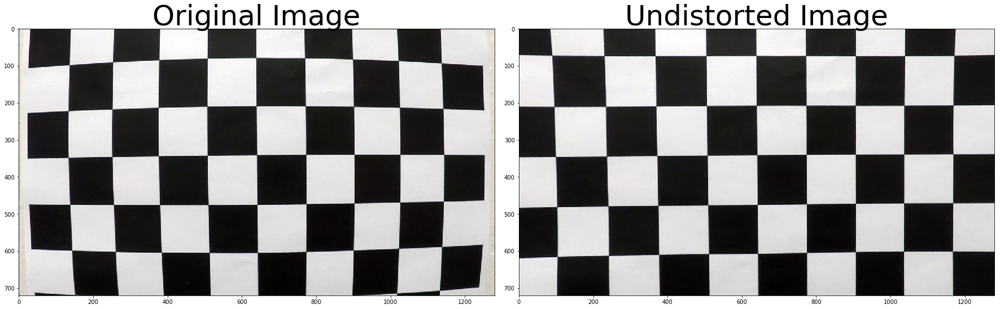

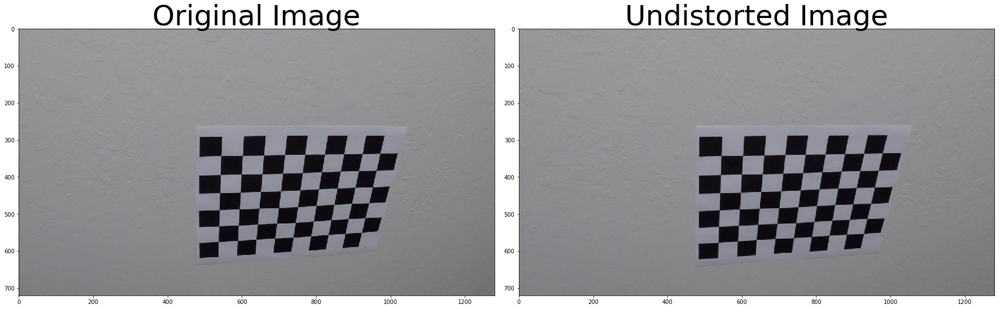

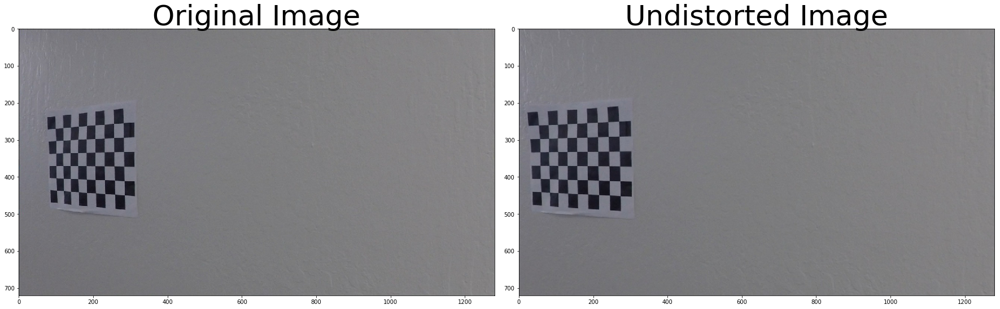

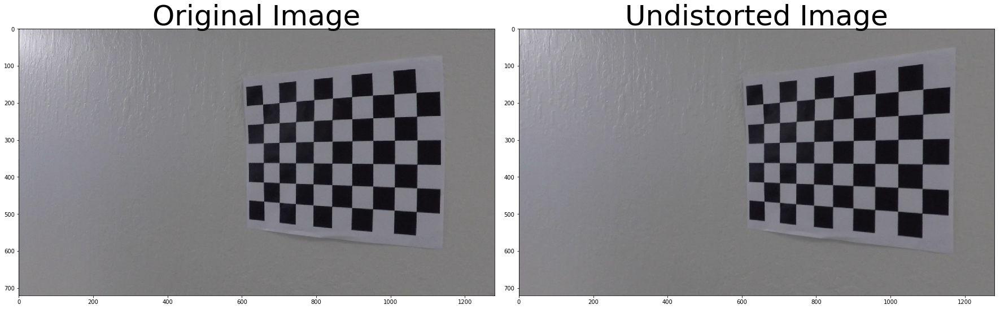

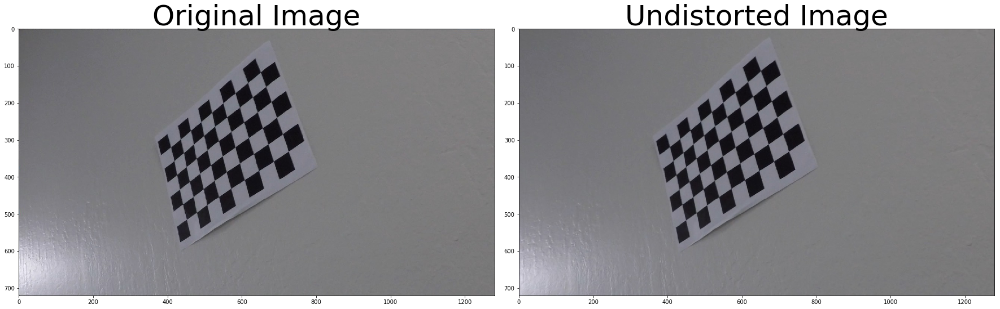

...

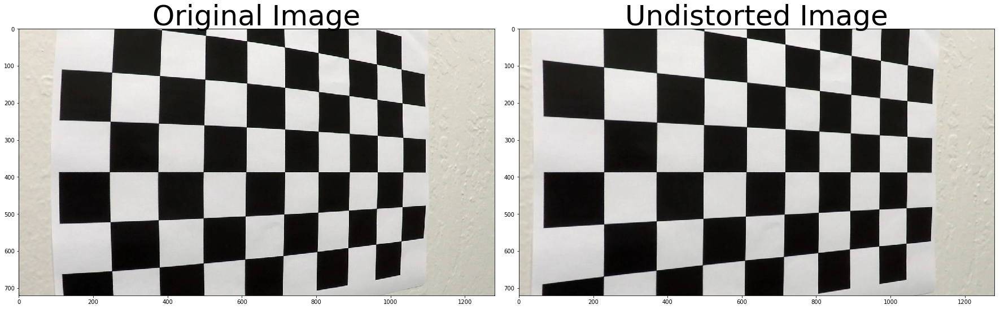

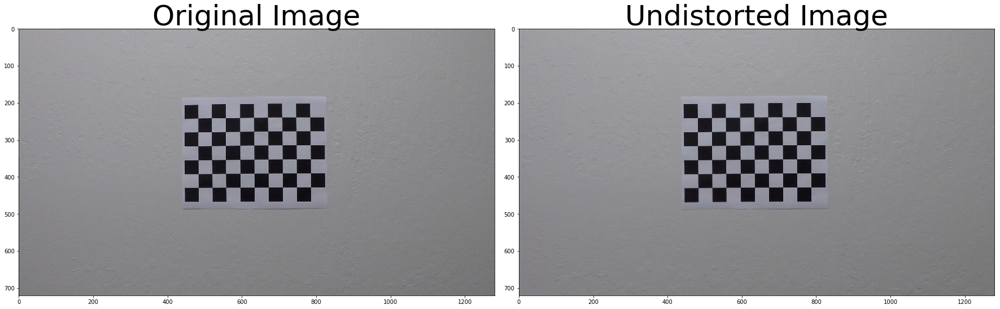

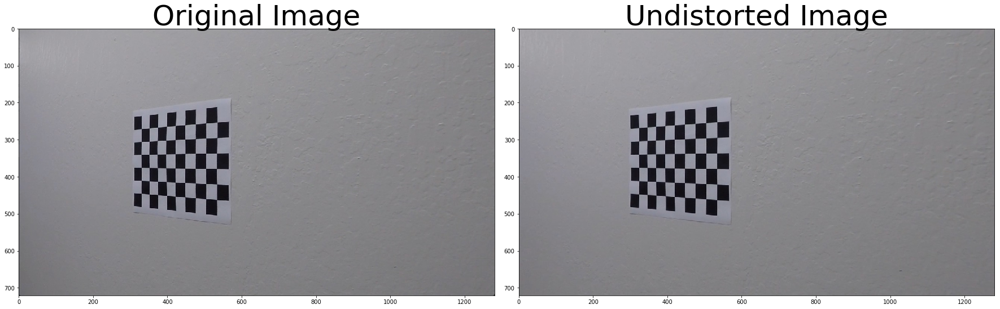

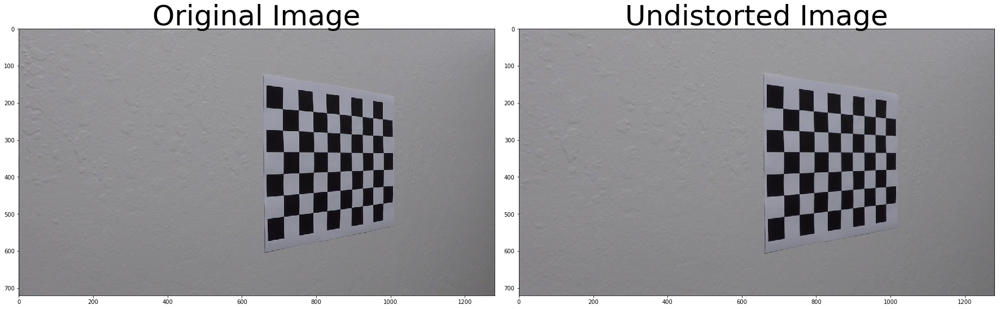

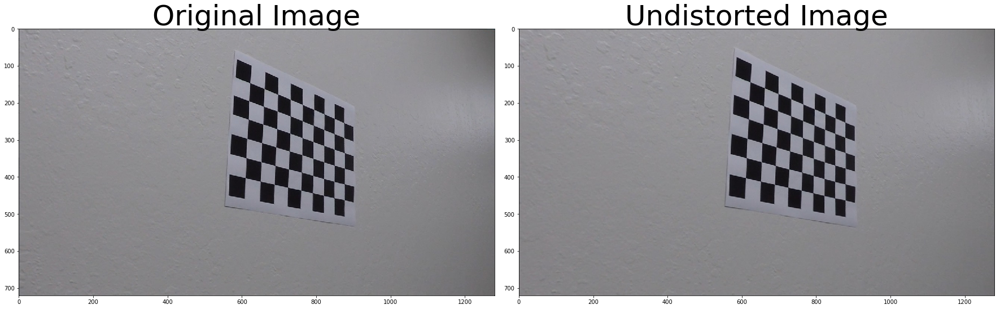

In [7]:
def undist(img, mtx=mtx, dist=dist):
    return cv2.undistort(img, mtx, dist, None, mtx)

def plot_before_n_after_undist(image):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(undist(image))
    ax2.set_title('Undistorted Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    
for file in images:
    img = mpimg.imread(file)
    plot_before_n_after_undist(img)

### Correcting for distortion and warpping

In [13]:
# Define a function that takes an image, number of x and y points, 
# camera matrix and distortion coefficients
def corners_unwarp(img, nx, ny, mtx=mtx, dist=dist):
    # Use the OpenCV undistort() function to remove distortion
    undist = cv2.undistort(img, mtx, dist)
    # Convert undistorted image to grayscale
    gray = cv2.cvtColor(undist, cv2.COLOR_BGR2GRAY)
    # Search for corners in the grayscaled image
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

    if ret == True:
        # If we found corners, draw them! (just for fun)
        cv2.drawChessboardCorners(undist, (nx, ny), corners, ret)
        # Choose offset from image corners to plot detected corners
        # This should be chosen to present the result at the proper aspect ratio
        # My choice of 100 pixels is not exact, but close enough for our purpose here
        offset = 100 # offset for dst points
        # Grab the image shape
        img_size = (gray.shape[1], gray.shape[0])

        # For source points I'm grabbing the outer four detected corners
        src = np.float32([corners[0], corners[nx-1], corners[-1], corners[-nx]])
        # For destination points, I'm arbitrarily choosing some points to be
        # a nice fit for displaying our warped result 
        # again, not exact, but close enough for our purposes
        dst = np.float32([[offset, offset], [img_size[0]-offset, offset], 
                                     [img_size[0]-offset, img_size[1]-offset], 
                                     [offset, img_size[1]-offset]])
        # Given src and dst points, calculate the perspective transform matrix
        M = cv2.getPerspectiveTransform(src, dst)
        # Warp the image using OpenCV warpPerspective()
        warped = cv2.warpPerspective(undist, M, img_size)

    # Return the resulting image and matrix
        return undist, warped
    else:
        return undist, undist

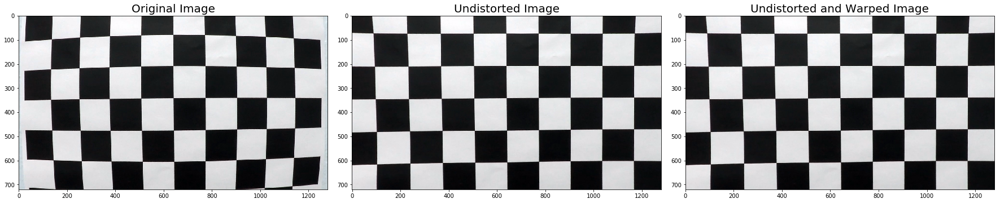

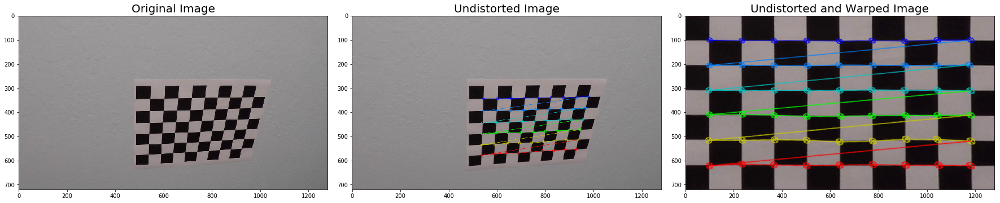

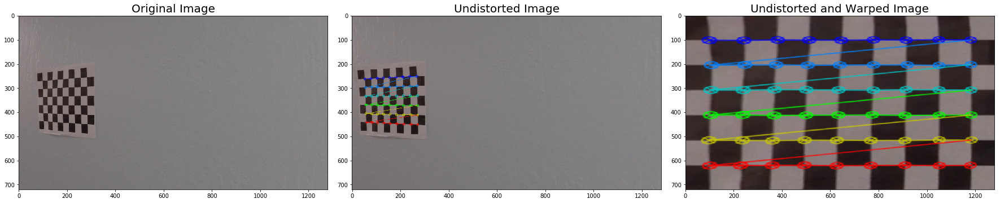

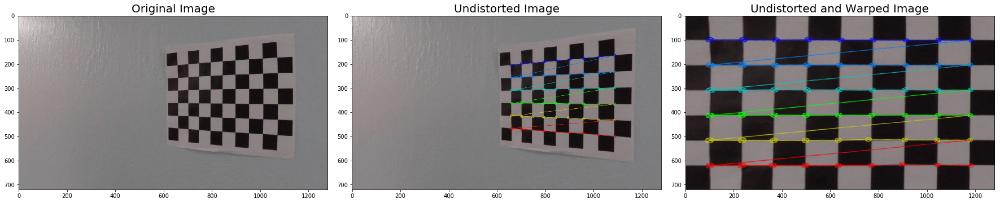

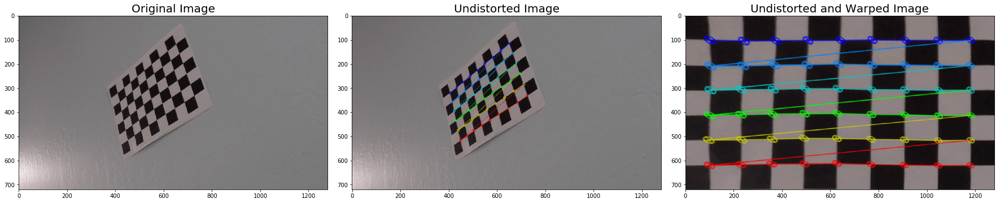

...

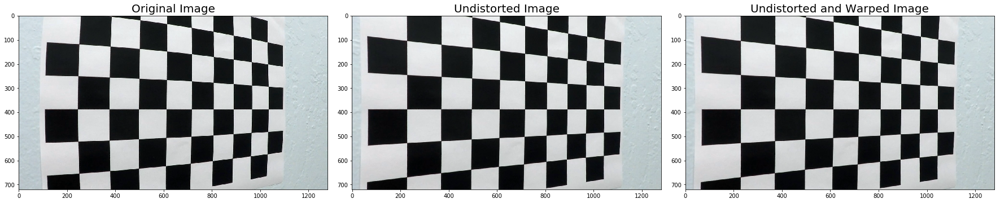

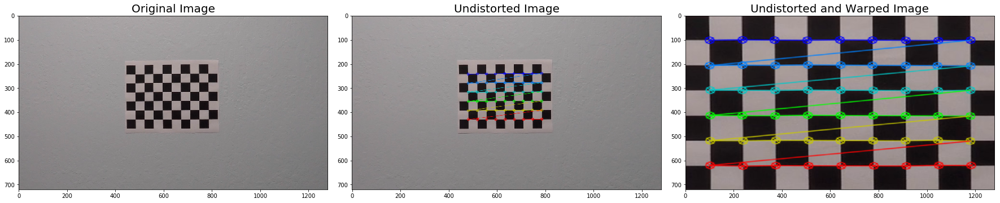

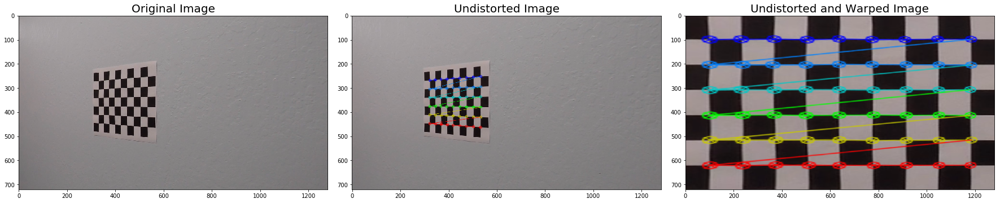

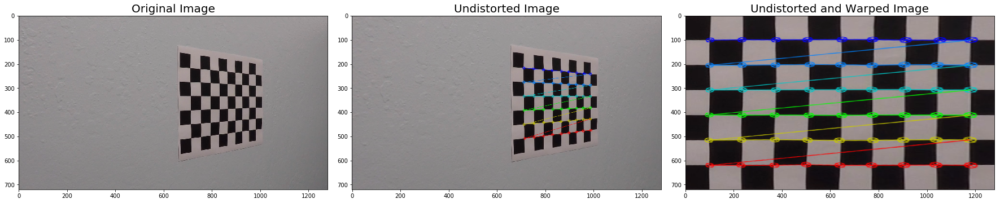

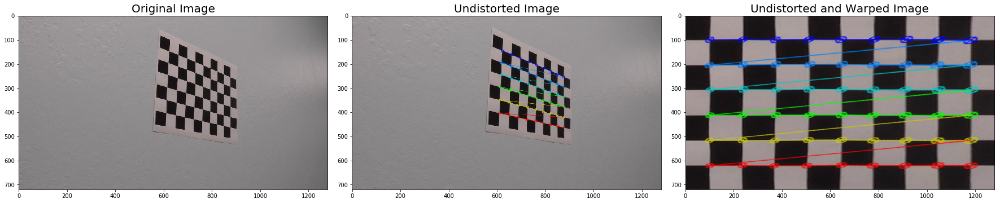

In [17]:
for file in images:
    img = cv2.imread(file)  
#     print(img.shape)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) 
#     print(gray.shape)
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny), None)
#     print(ret, corners)
    top_down = None
    undist, top_down = corners_unwarp(img, nx=nx, ny=ny)
    
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(undist)
    ax2.set_title('Undistorted Image', fontsize=20)
    ax3.imshow(top_down)
    ax3.set_title('Undistorted and Warped Image', fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()